In [2]:
import pandas as pd
from PIL import Image
import os
import matplotlib.pyplot as plt
import random
import numpy as np
from collections import Counter
import seaborn as sns
import ast 
import math


# Loading the data

In [3]:
category_attributes = pd.read_parquet('data\category_attributes.parquet')

category_attributes.head()

,Category,No_of_attribute,Attribute_list
0,Men Tshirts,5,"[color, neck, pattern, print_or_pattern_type, ..."
1,Sarees,10,"[blouse_pattern, border, border_width, color, ..."
2,Kurtis,9,"[color, fit_shape, length, occasion, ornamenta..."
3,Women Tshirts,8,"[color, fit_shape, length, pattern, print_or_p..."
4,Women Tops & Tunics,10,"[color, fit_shape, length, neck_collar, ocassi..."


In [10]:
train_df = pd.read_csv('data/train.csv')

train_df.head()

,id,Category,len,attr_1,attr_2,attr_3,attr_4,attr_5,attr_6,attr_7,attr_8,attr_9,attr_10
0,0,Men Tshirts,5,default,round,printed,default,short sleeves,NaN,NaN,NaN,NaN,NaN
1,1,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,NaN,NaN,NaN,NaN,NaN
2,2,Men Tshirts,5,default,polo,solid,solid,short sleeves,NaN,NaN,NaN,NaN,NaN
3,3,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,NaN,NaN,NaN,NaN,NaN
4,4,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,NaN,NaN,NaN,NaN,NaN


In [5]:
test_df = pd.read_csv('data/test.csv')

test_df.head()

,id,Category
0,0,Men Tshirts
1,1,Men Tshirts
2,2,Men Tshirts
3,3,Men Tshirts
4,4,Men Tshirts


# EDA

## Category

In [6]:
class_distribution = train_df['Category'].value_counts().sort_index()

class_distribution

Category
Kurtis                  6822
Men Tshirts             7267
Sarees                 18346
Women Tops & Tunics    19004
Women Tshirts          18774
Name: count, dtype: int64

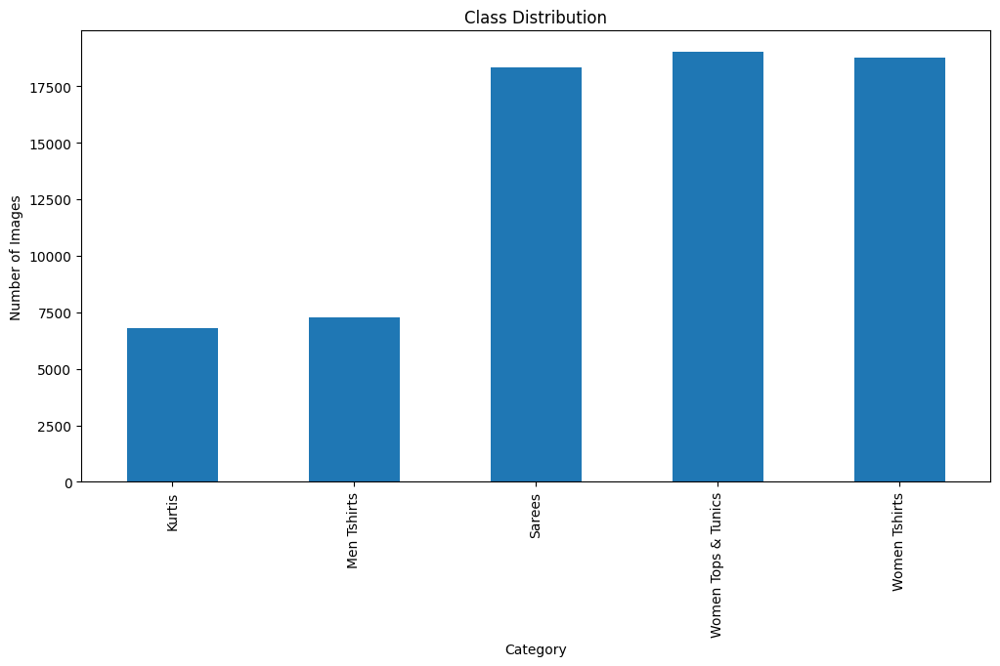

In [6]:
class_distribution.plot(kind='bar', figsize=(12, 6))
plt.title('Class Distribution')
plt.xlabel('Category')
plt.ylabel('Number of Images')
plt.show()

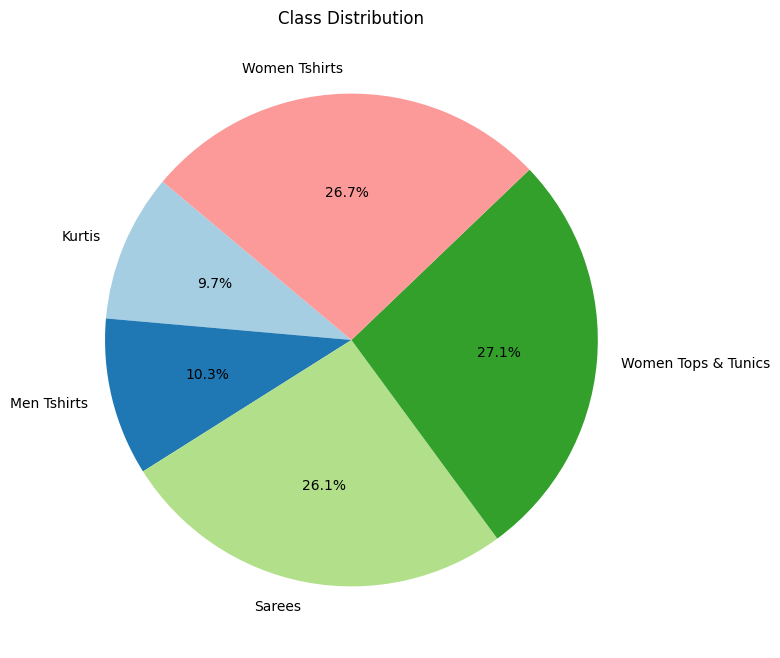

In [7]:
plt.figure(figsize = (8,8))
class_distribution.plot(kind='pie', autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
plt.title('Class Distribution')
plt.ylabel('')
plt.show()

<Axes: title={'center': 'Total Number of Attributes by Category'}, xlabel='Category', ylabel='Total Number of Attributes'>

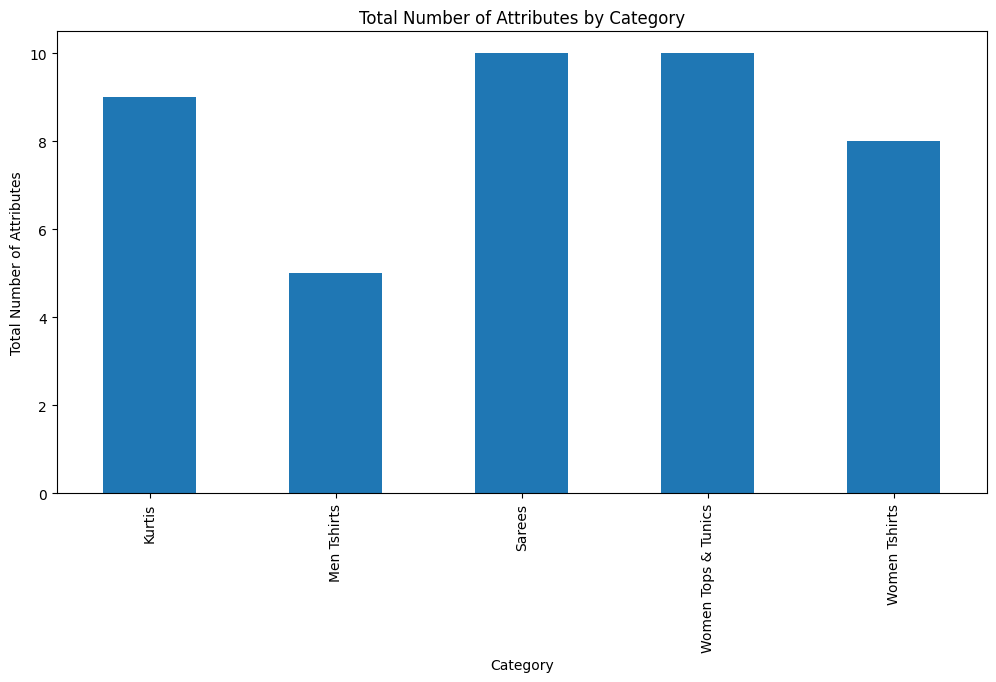

In [7]:
category_counts = category_attributes.groupby('Category')['No_of_attribute'].mean()
category_counts.plot(kind='bar', title='Total Number of Attributes by Category', figsize=(12, 6), xlabel='Category', ylabel='Total Number of Attributes')

In [9]:
attribute_columns = [col for col in train_df.columns if col.startswith("attr_")]

# Dictionary to store attribute values for each category
category_attr_dict = {}

# Extract unique attribute values for each category and attribute
for category, group in train_df.groupby("Category"):
    attr_values = {}
    for attr in attribute_columns:
        unique_values = ", ".join(group[attr].dropna().unique().astype(str))
        attr_values[attr] = unique_values
    category_attr_dict[category] = attr_values

# Convert to a DataFrame for easy visualization
category_attr_df = pd.DataFrame(category_attr_dict).T
category_attr_df = category_attr_df.fillna("")

# Color coding function
def color_attributes(val):
    if val == "":
        color = 'lightgrey'
    else:
        color = sns.color_palette("viridis", n_colors=10)[hash(val) % 10]  # Using hash for consistent coloring
    return f'background-color: {color}'

# Apply color coding to DataFrame
category_attr_df_styled = category_attr_df.style.applymap(color_attributes)

# Display styled DataFrame
category_attr_df_styled

C:\Users\Ritika\AppData\Local\Temp\ipykernel_34532\1830544236.py:27: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  category_attr_df_styled = category_attr_df.style.applymap(color_attributes)


,attr_1,attr_2,attr_3,attr_4,attr_5,attr_6,attr_7,attr_8,attr_9,attr_10
Kurtis,"black, red, navy blue, maroon, green, pink, blue, purple, grey, yellow, white, multicolor, orange","straight, a-line","knee length, calf length","daily, party","net, default","solid, default","solid, default","three-quarter sleeves, short sleeves, sleeveless","regular, sleeveless",
Men Tshirts,"default, multicolor, black, white","round, polo","printed, solid","default, solid, typography","short sleeves, long sleeves",,,,,
Sarees,"same as saree, solid, same as border, default","woven design, zari, no border, solid, default, temple border","small border, big border, no border","multicolor, cream, white, default, navy blue, yellow, green, pink","party, traditional, daily, wedding","jacquard, default, tassels and latkans","woven design, same as saree, default, zari woven","zari woven, woven design, default, solid, printed","applique, elephant, floral, ethnic motif, peacock, default, solid, checked, botanical","no, yes"
Women Tops & Tunics,"black, navy blue, red, default, maroon, white, green, blue, pink, yellow, peach, multicolor","regular, fitted, boxy, default","crop, regular","high, round neck, stylised, sweetheart neck, v-neck, square neck, default","casual, party","default, printed, solid","solid, typography, graphic, default, quirky, floral","short sleeves, sleeveless, three-quarter sleeves, long sleeves","regular sleeves, default, sleeveless, puff sleeves","knitted, default, ruffles, waist tie-ups, tie-ups, applique"
Women Tshirts,"multicolor, yellow, black, default, pink, maroon, white","loose, boxy, regular","long, crop, regular","default, solid, printed","default, quirky, solid, graphic, funky print, typography","default, long sleeves, short sleeves","regular sleeves, cuffed sleeves","default, applique",,


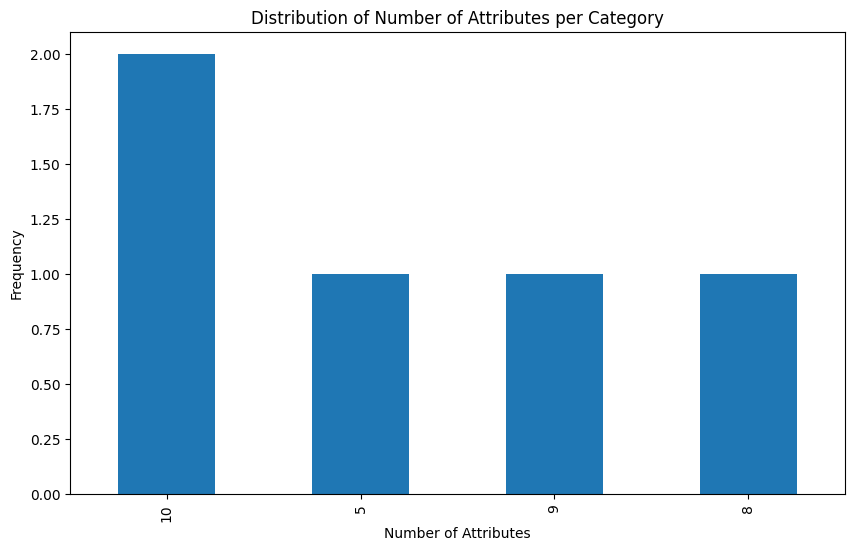

In [10]:
plt.figure(figsize=(10, 6))
category_attributes['No_of_attribute'].value_counts().plot(kind='bar')
plt.title("Distribution of Number of Attributes per Category")
plt.xlabel("Number of Attributes")
plt.ylabel("Frequency")
plt.show()

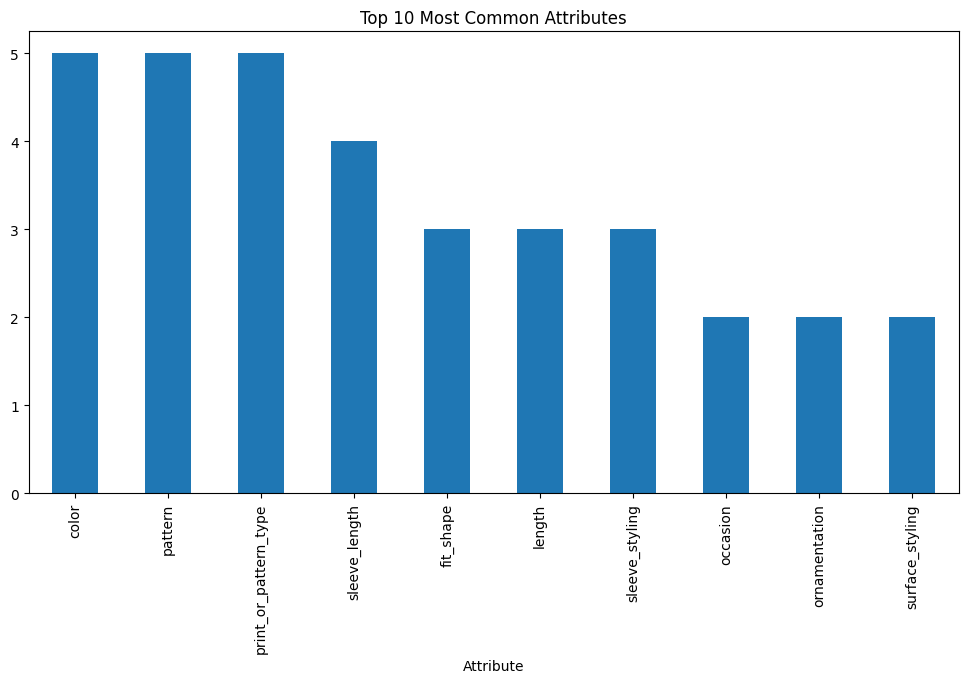

In [11]:
all_attributes = category_attributes['Attribute_list'].explode()
attribute_counts = Counter(all_attributes)
common_attributes = pd.DataFrame(attribute_counts.most_common(10), columns=['Attribute', 'Frequency'])

common_attributes.plot(kind='bar', x='Attribute', y='Frequency', legend=False, title="Top 10 Most Common Attributes", figsize=(12, 6))
plt.show()

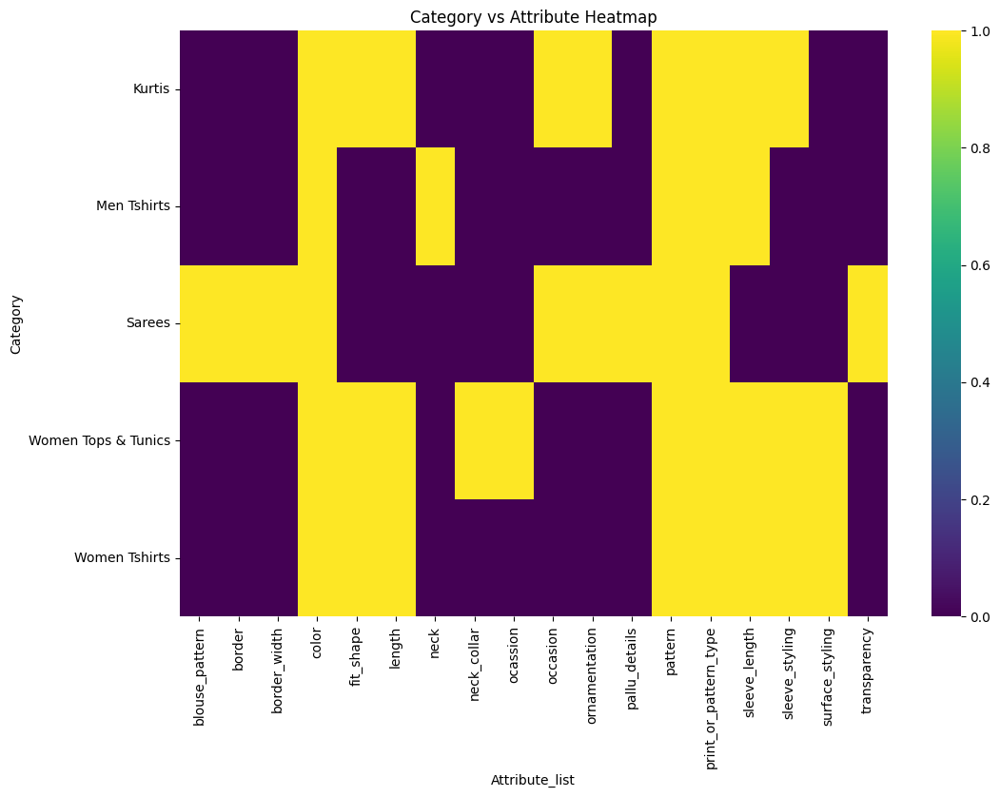

In [12]:
category_attribute_matrix = category_attributes.explode('Attribute_list').pivot_table(
    index='Category', columns='Attribute_list', aggfunc='size', fill_value=0)
plt.figure(figsize=(12, 8))
sns.heatmap(category_attribute_matrix, cmap='viridis')
plt.title("Category vs Attribute Heatmap")
plt.show()


In [13]:
print(type(category_attributes)) 

<class 'pandas.core.frame.DataFrame'>


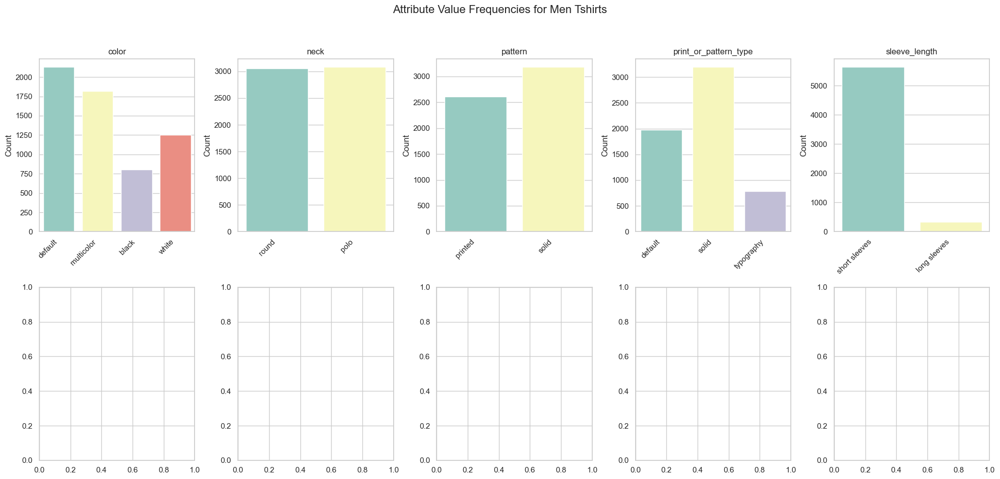

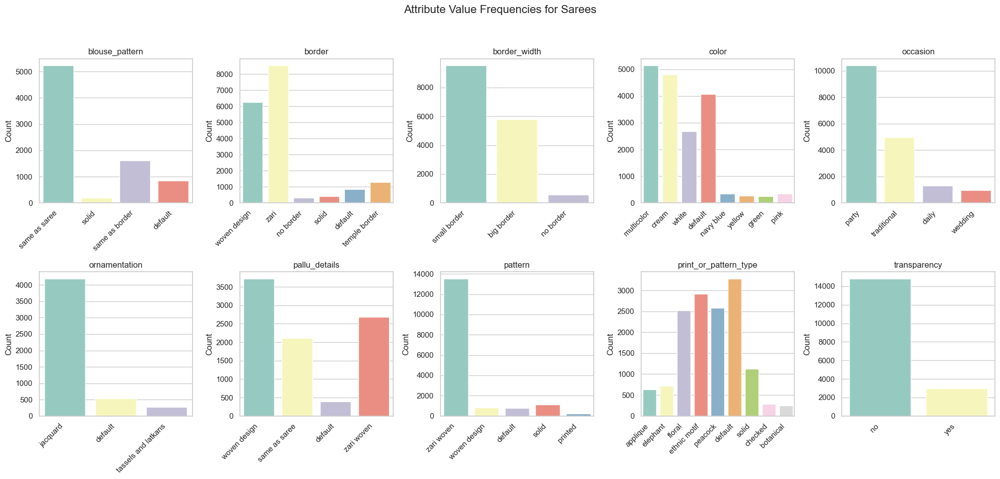

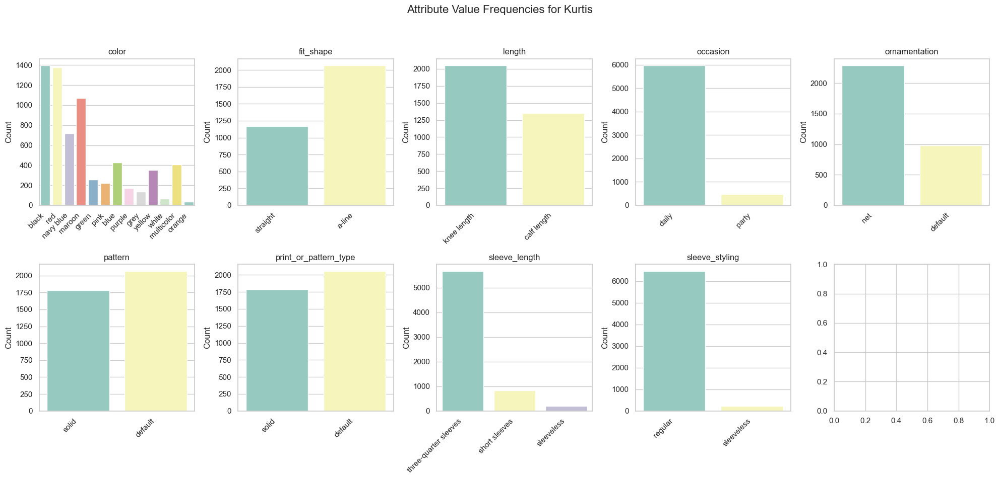

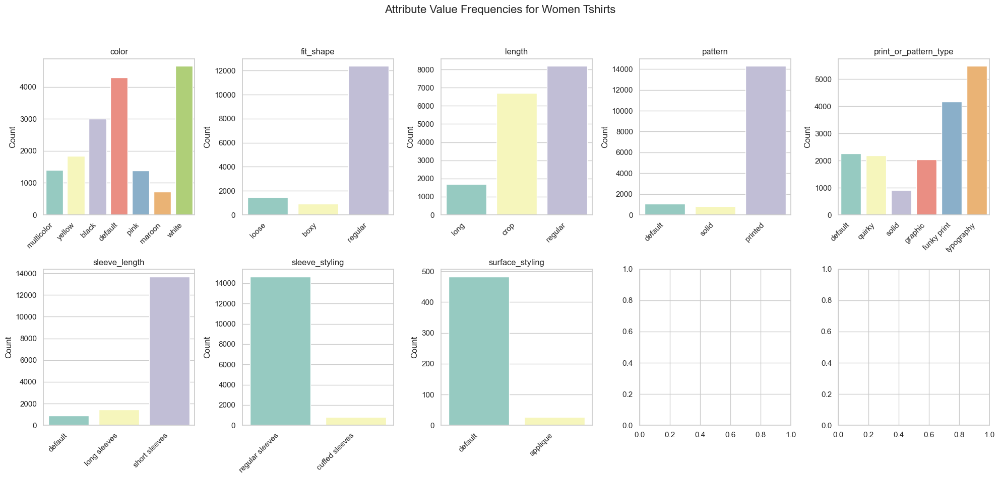

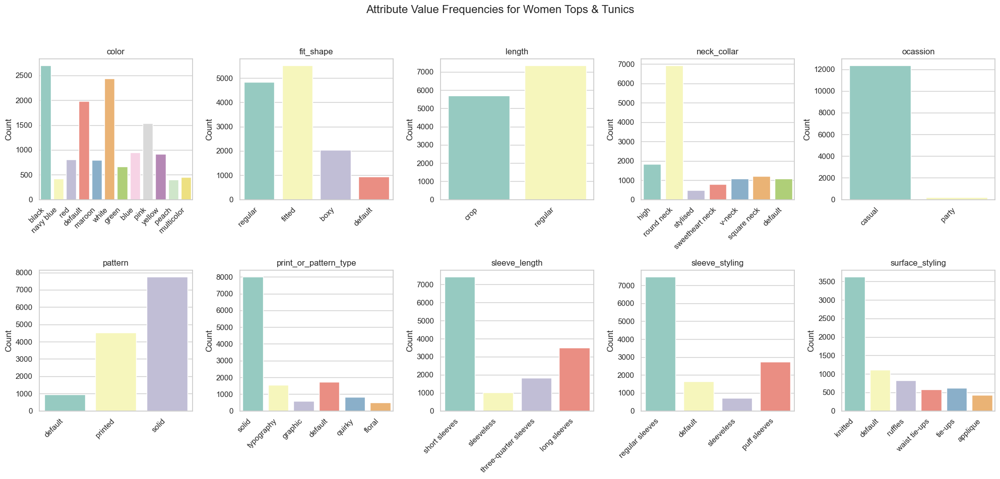

In [14]:
# Set the style and size of the plot
sns.set_theme(style="whitegrid")

# Loop through each category and plot frequencies for each attribute
for category in category_attributes['Category'].unique():
    fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20, 10))
    fig.suptitle(f'Attribute Value Frequencies for {category}', fontsize=16)
    
    # Filter the DataFrame for the current category
    category_df = train_df[train_df['Category'] == category]
    
    attributes = category_attributes.loc[category_attributes['Category'] == category, 'Attribute_list'].values
    
    attributes = attributes[0]  

    # Create a mapping for the current category
    attribute_mapping = {f'attr_{i + 1}': attributes[i] for i in range(len(attributes)) if attributes[i]}

    # Loop through each attribute and create a count plot
    for i, attr in enumerate(attribute_mapping.keys()):
        ax = axes[i // 5, i % 5]  # Determine subplot position
        
        # Create a count plot for each attribute
        sns.countplot(data=category_df, x=attr, hue=attr, palette="Set3", ax=ax, legend=False)

        # Set titles using the mapping and adjust the rotation for readability
        attr_name = attribute_mapping[attr] if attr in attribute_mapping else attr
        ax.set_title(attr_name if category_df[attr].notna().any() else attr)

        # Rotate x-tick labels
        plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')

        ax.set_xlabel('')
        ax.set_ylabel('Count')

    # Adjust layout for better spacing
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

In [ ]:
# Set the style and size of the plot
sns.set_theme(style="whitegrid")

# Loop through each category and create scatter plots for each attribute pair
for category in category_attributes['Category'].unique():
    # Filter the DataFrame for the current category
    category_df = train_df[train_df['Category'] == category]
    
    # Get the list of attributes for the current category
    attributes = category_attributes.loc[category_attributes['Category'] == category, 'Attribute_list'].values[0]

    # Create a mapping for the current category
    attribute_mapping = {f'attr_{i + 1}': attributes[i] for i in range(len(attributes)) if attributes[i]}
    
    # Get attribute names from the attribute_mapping for scatter plots
    attribute_cols = list(attribute_mapping.keys())
    
    # Calculate the number of attribute pairs for scatter plots
    num_pairs = len(attribute_cols) - 1
    num_rows = math.ceil(num_pairs / 2)  # 2 columns per row
    
    # Generate scatter plots for each pair of attributes in the current category
    fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(15, 5 * num_rows))
    fig.suptitle(f'Scatter Plots for {category}', fontsize=16)
    
    # Flatten axes array for easier indexing if more than one row
    axes = axes.flatten() if num_pairs > 1 else [axes]
    
    # Create pairs of attributes to plot against each other
    for i, (attr1, attr2) in enumerate(zip(attribute_cols[:-1], attribute_cols[1:])):
        # Plot scatter plot between the two attributes
        sns.scatterplot(data=category_df, x=attr1, y=attr2, ax=axes[i])
        
        # Set plot titles and labels
        axes[i].set_title(f'{attribute_mapping[attr1]} vs {attribute_mapping[attr2]}')
        axes[i].set_xlabel(attribute_mapping[attr1])
        axes[i].set_ylabel(attribute_mapping[attr2])

    # Hide any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    # Adjust layout for better spacing
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


In [16]:
# for category in category_attributes['Category'].unique():
#     # Filter for the current category
#     category_df = train_df[train_df['Category'] == category]
    
#     # Get attributes for the current category
#     attributes = category_attributes.loc[category_attributes['Category'] == category, 'Attribute_list'].values[0]
#     attribute_mapping = {f'attr_{i + 1}': attributes[i] for i in range(len(attributes)) if attributes[i]}
#     attribute_cols = list(attribute_mapping.keys())
    
#     # Calculate pairwise frequency table for two attributes (e.g., attr_1 and attr_2)
#     for i in range(len(attribute_cols) - 1):
#         attr1, attr2 = attribute_cols[i], attribute_cols[i + 1]
#         cross_tab = pd.crosstab(category_df[attr1], category_df[attr2])
        
#         plt.figure(figsize=(10, 8))
#         sns.heatmap(cross_tab, annot=True, cmap="YlGnBu", fmt="d")
#         plt.title(f'Heatmap of {attribute_mapping[attr1]} vs {attribute_mapping[attr2]} for {category}')
#         plt.xlabel(attribute_mapping[attr2])
#         plt.ylabel(attribute_mapping[attr1])
#         plt.show()

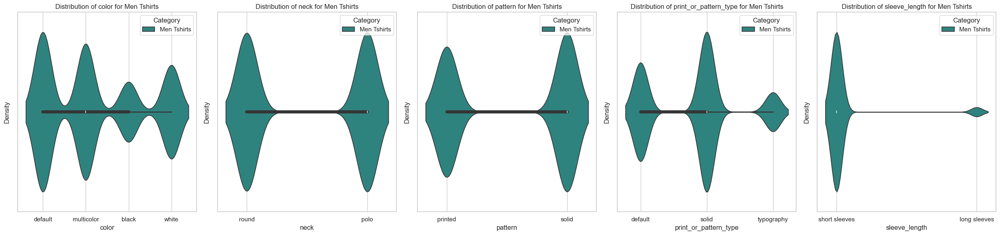

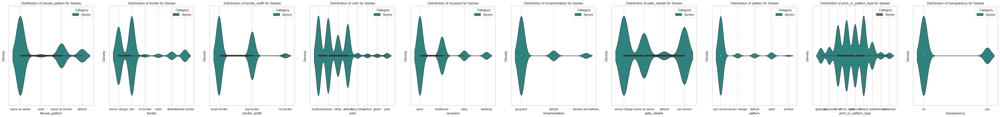

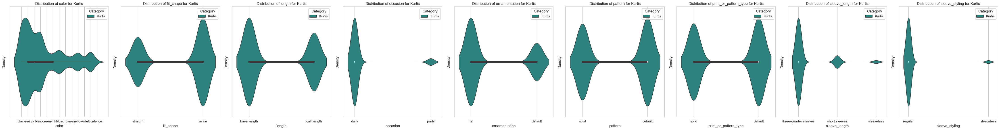

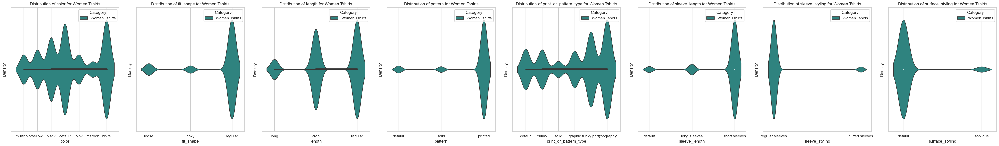

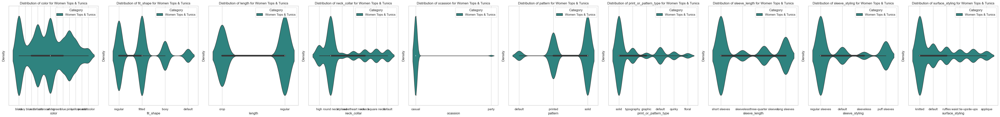

In [17]:
for category in category_attributes['Category'].unique():
    category_df = train_df[train_df['Category'] == category]
    attributes = category_attributes.loc[category_attributes['Category'] == category, 'Attribute_list'].values[0]
    attribute_mapping = {f'attr_{i + 1}': attributes[i] for i in range(len(attributes)) if attributes[i]}
    attribute_cols = list(attribute_mapping.keys())

    fig, axes = plt.subplots(nrows=1, ncols=len(attribute_cols), figsize=(5 * len(attribute_cols), 6))

    for i, attr in enumerate(attribute_cols):
        sns.violinplot(data=category_df, x=attr, ax=axes[i], inner='box', palette='viridis', hue='Category')
        axes[i].set_title(f'Distribution of {attribute_mapping[attr]} for {category}')
        axes[i].set_xlabel(attribute_mapping[attr])
        axes[i].set_ylabel('Density')
    
    plt.tight_layout()
    plt.show()


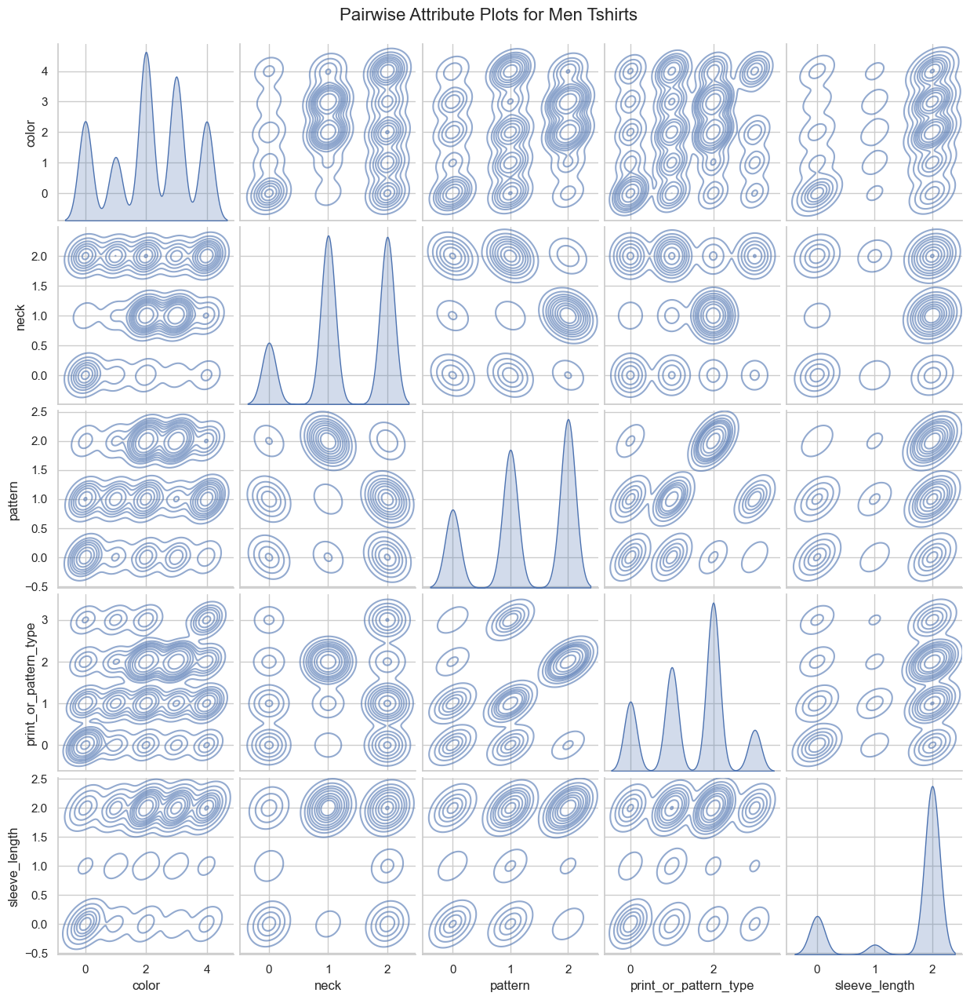

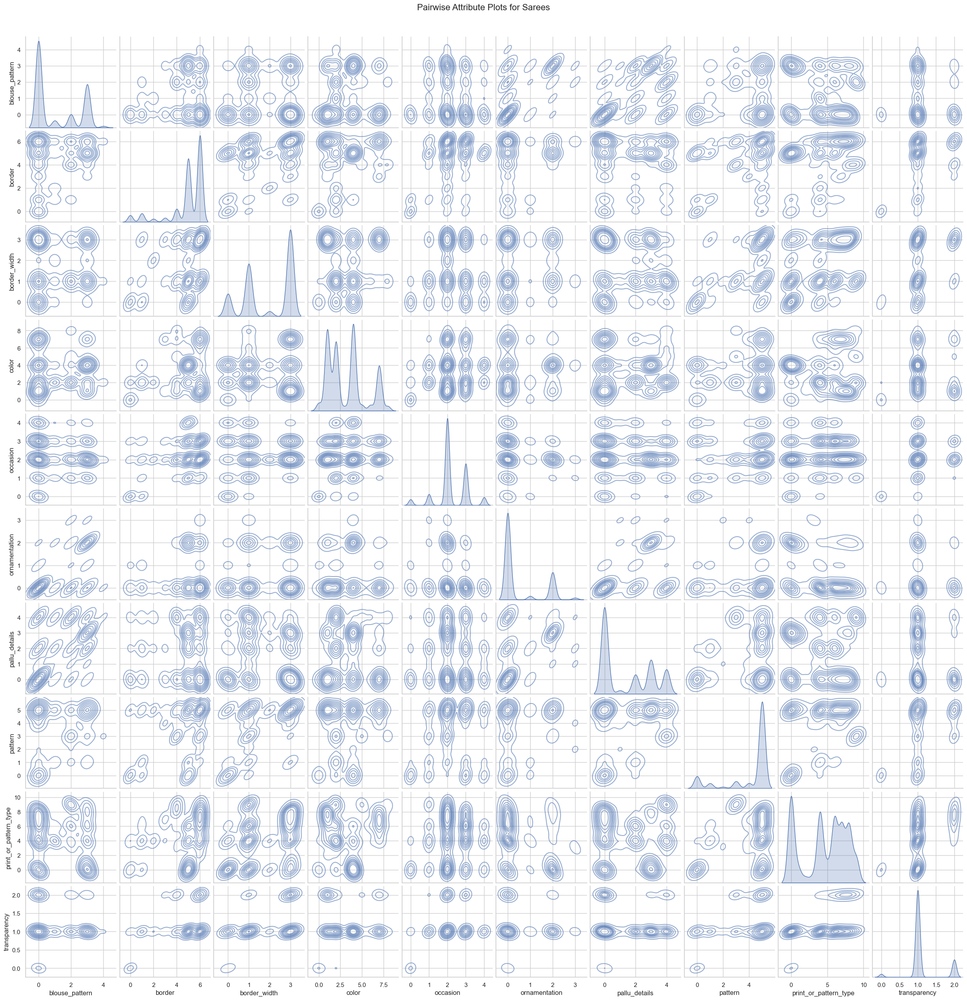

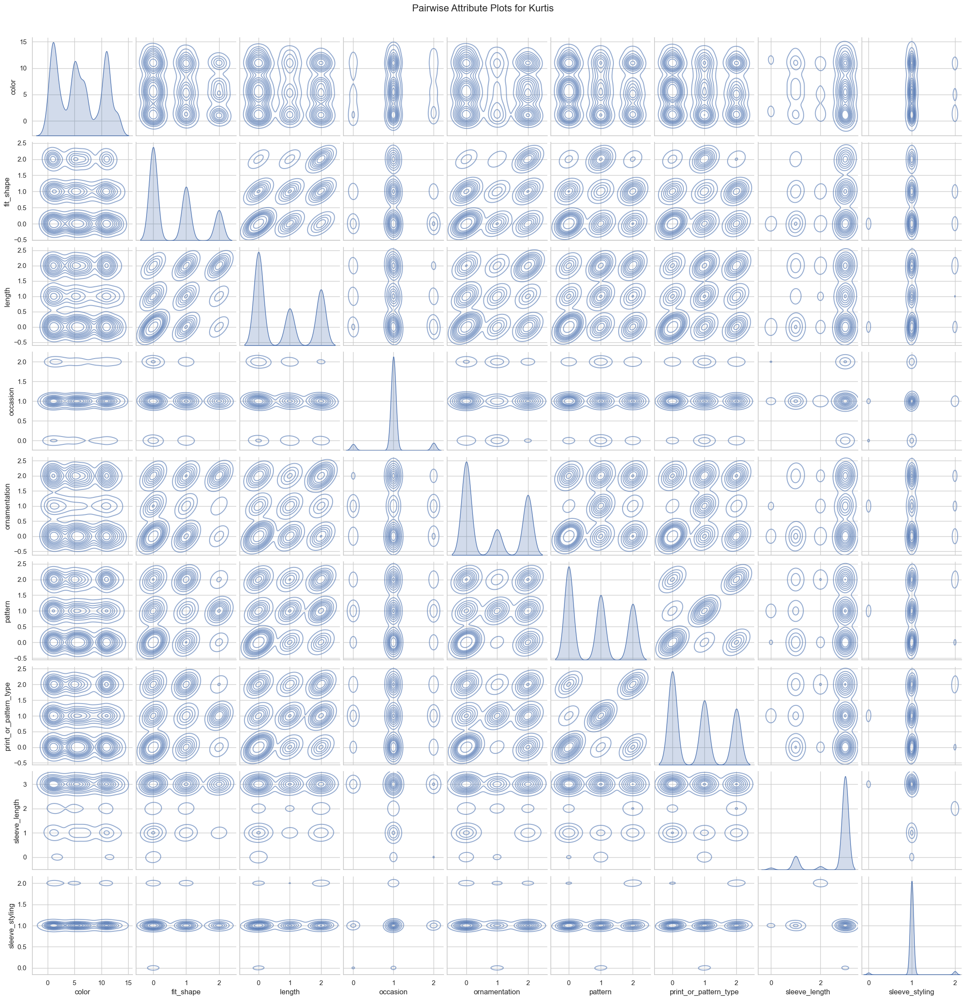

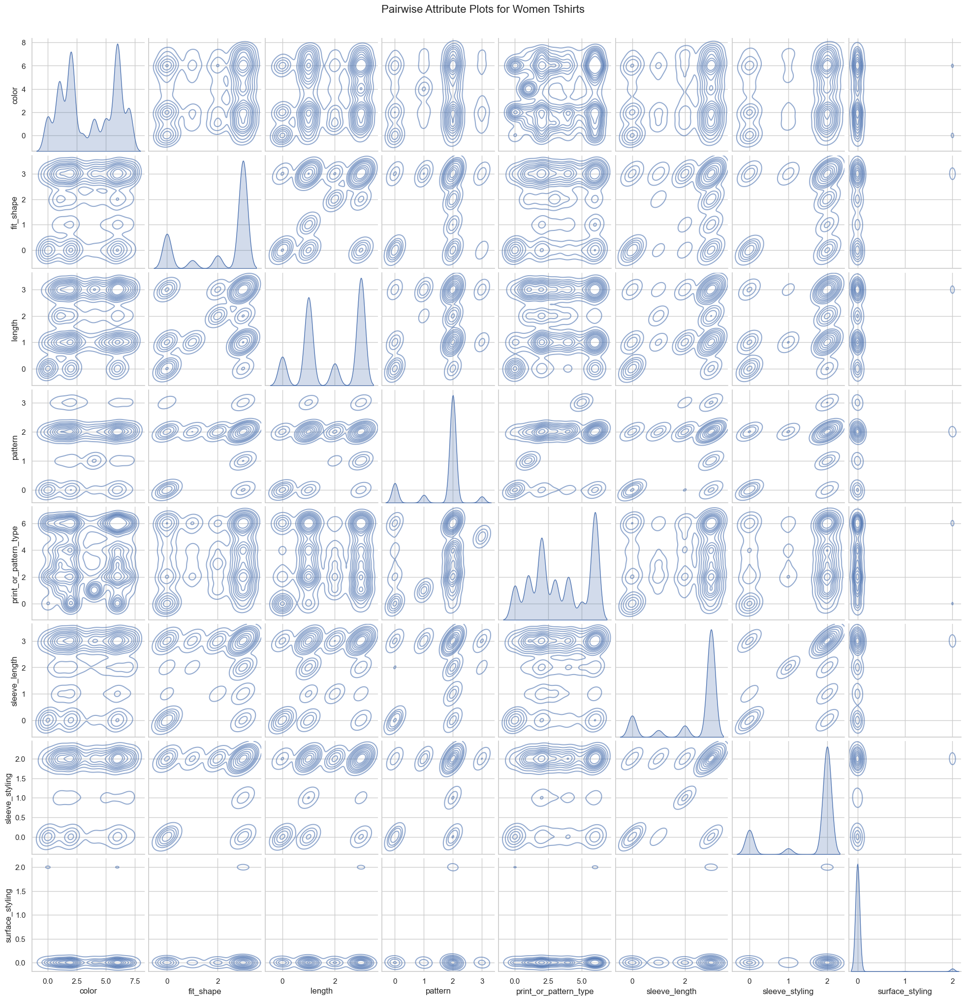

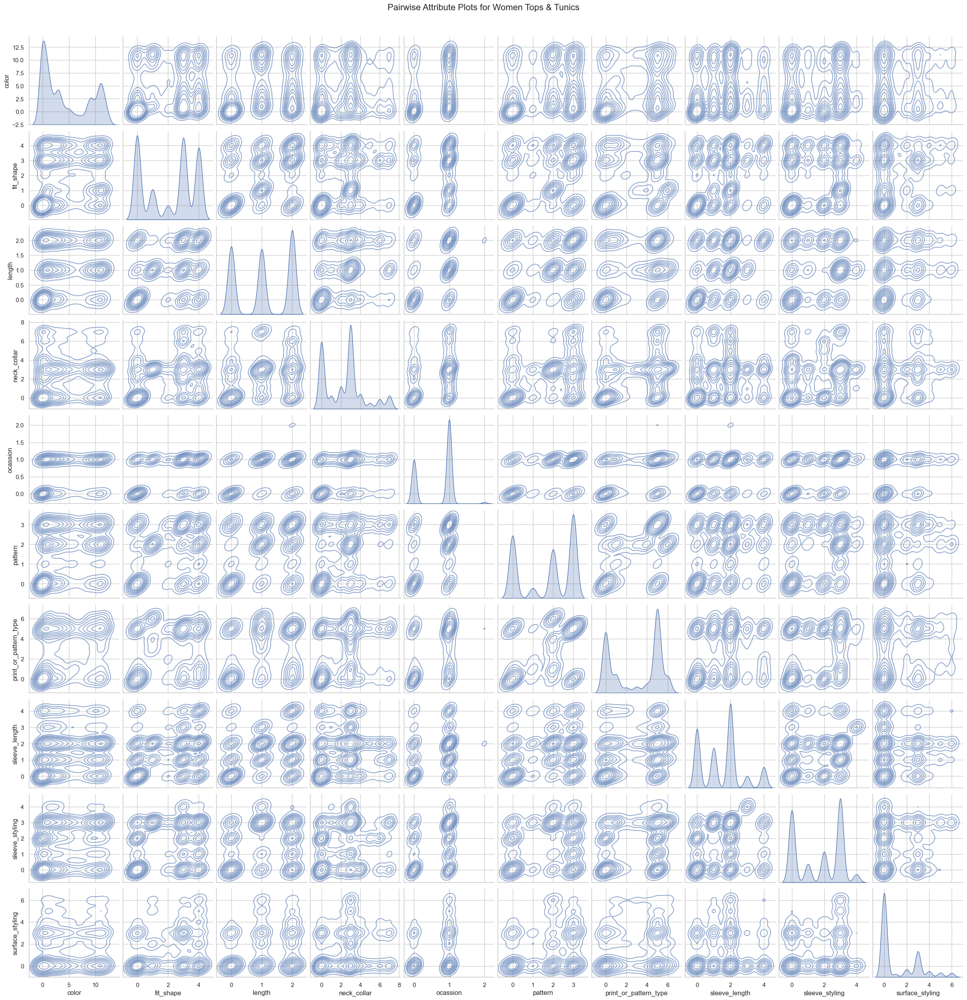

In [18]:
for category in category_attributes['Category'].unique():
    # Filter the DataFrame for the current category
    category_df = train_df[train_df['Category'] == category]
    
    # Extract attributes for the current category
    attributes = category_attributes.loc[category_attributes['Category'] == category, 'Attribute_list'].values[0]
    attribute_mapping = {f'attr_{i + 1}': attributes[i] for i in range(len(attributes)) if attributes[i]}
    
    # Select only the relevant columns in category_df
    attribute_cols = list(attribute_mapping.keys())
    category_df_subset = category_df[attribute_cols].copy()
    
    # Rename columns for plotting to be more descriptive
    renamed_df = category_df_subset.rename(columns=attribute_mapping)
    
    # Convert non-numeric columns to numeric codes, starting from 0
    if not all(renamed_df.dtypes.apply(lambda x: np.issubdtype(x, np.number))):
        for col in renamed_df.select_dtypes(include=['object']).columns:
            renamed_df[col] = renamed_df[col].fillna("Unknown").astype('category').cat.codes
    
    # Plot pairplot for the attributes in the current category
    sns.pairplot(renamed_df, kind='kde', plot_kws={'alpha': 0.6})
    plt.suptitle(f'Pairwise Attribute Plots for {category}', y=1.02, fontsize=16)
    plt.show()

## Training csv

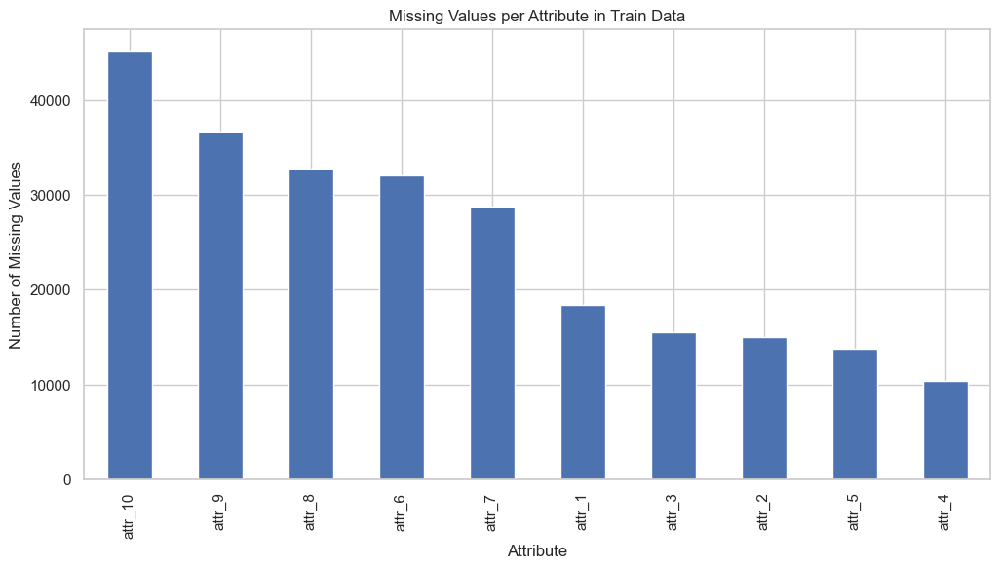

In [19]:
missing_values = train_df.iloc[:, 3:].isna().sum().sort_values(ascending=False)
missing_values.plot(kind='bar', title="Missing Values per Attribute in Train Data", figsize=(12, 6), xlabel='Attribute', ylabel='Number of Missing Values')
plt.show()

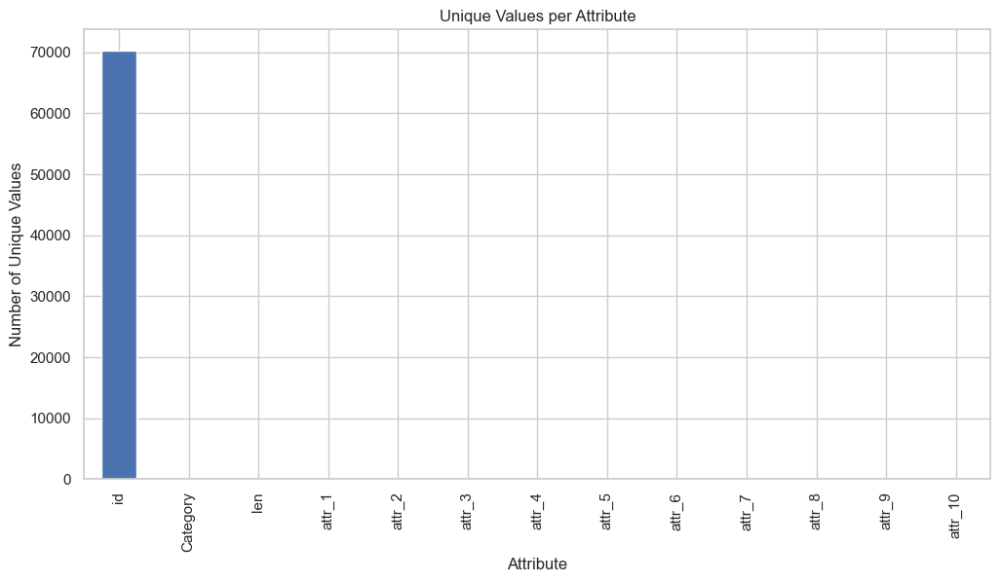

In [20]:
unique_counts = train_df.nunique()
unique_counts.plot(kind='bar', title="Unique Values per Attribute", figsize=(12, 6), xlabel='Attribute', ylabel='Number of Unique Values')
plt.show()

In [21]:
attribute_columns = [col for col in train_df.columns if col.startswith("attr_")]

# Group by "Category" and get the most common attribute combinations across all 10 attributes
category_attr_combinations = (
    train_df.groupby("Category")[attribute_columns]
    .apply(lambda x: x.value_counts().head())
)

print(category_attr_combinations)

Category             attr_1         attr_2        attr_3        attr_4      attr_5       attr_6    attr_7        attr_8         attr_9           attr_10
Sarees               same as saree  woven design  small border  multicolor  party        jacquard  woven design  zari woven     applique         no         519
                                    zari          small border  cream       party        jacquard  woven design  zari woven     peacock          no         167
                                                                                                                                floral           no         133
                                                                            traditional  jacquard  woven design  zari woven     peacock          no          67
                                                                            party        jacquard  woven design  zari woven     elephant         no          60
Women Tops & Tunics  white          boxy       

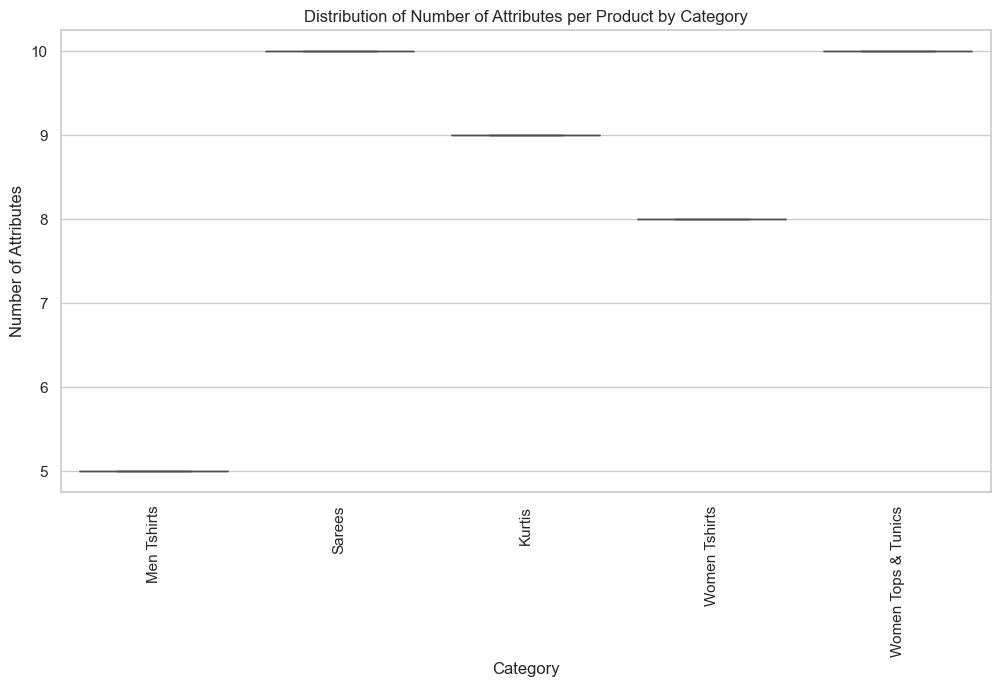

In [22]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='Category', y='len', data=train_df)
plt.title("Distribution of Number of Attributes per Product by Category")
plt.xlabel("Category")
plt.ylabel("Number of Attributes")
plt.xticks(rotation=90)
plt.show()

## Overview of the dataset

In [23]:
heights = []
widths = []

In [24]:
aspect_ratios = []

In [25]:
avg_reds = []
avg_greens = []
avg_blues = []

### 10 random samples from the dataset

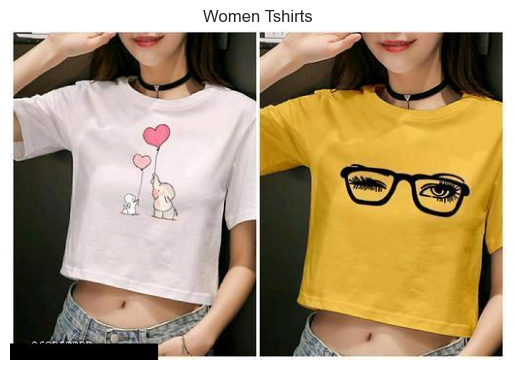

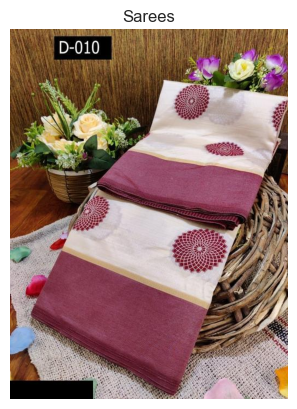

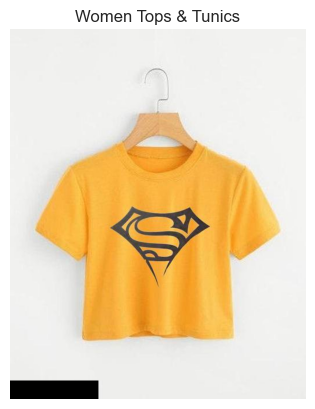

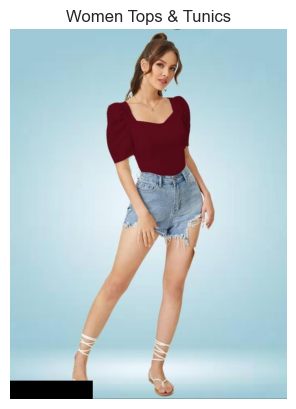

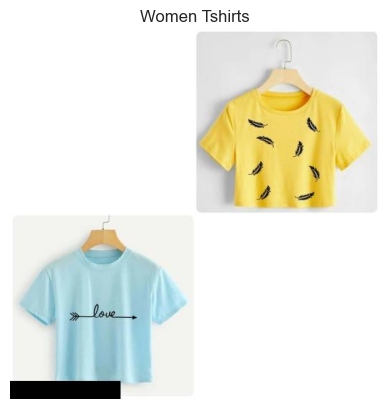

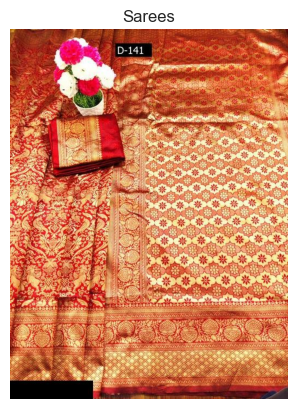

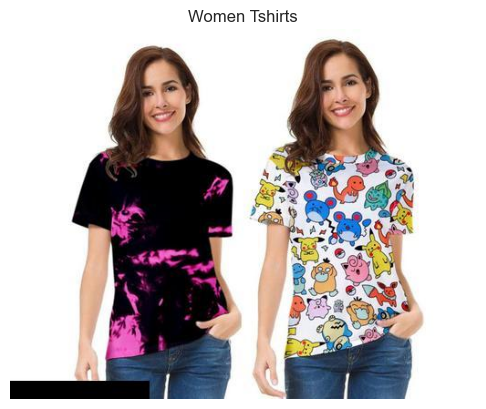

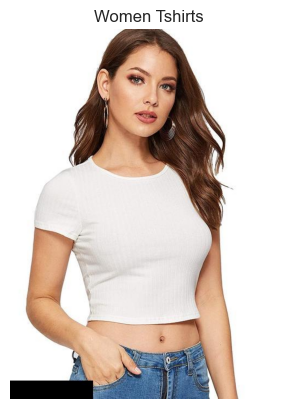

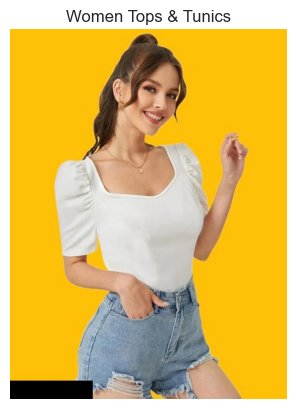

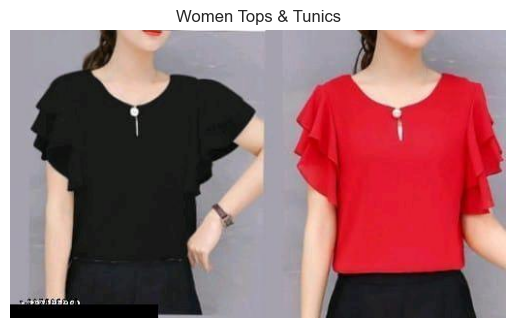

In [26]:
image_files = os.listdir('data/train_images')
selected_images = random.sample(image_files, 10)

for img_file in selected_images:
    img = plt.imread(f'data/train_images/{img_file}')
    img_id = int(img_file.split('.')[0])
    category = train_df[train_df['id'] == img_id]['Category'].values[0]

    plt.imshow(img)
    plt.title(category)
    plt.axis('off')
    plt.show()

In [27]:
# calculate the average height, width, aspect ratio, and color intensity of the images

for img_file in image_files:
    # Get image ID from filename
    img_id = int(img_file.split('.')[0])

    # Check if the image ID exists in train_df
    category_row = train_df[train_df['id'] == img_id]
    if category_row.empty:
        continue  # Skip if no match is found

    # Open image to get dimensions and calculate aspect ratio
    img = Image.open(f'data/train_images/{img_file}')
    heights.append(img.height)
    widths.append(img.width)
    aspect_ratios.append(img.width / img.height)

    # Calculate average color intensities
    img = plt.imread(f'data/train_images/{img_file}')
    avg_reds.append(img[:, :, 0].mean())
    avg_greens.append(img[:, :, 1].mean())
    avg_blues.append(img[:, :, 2].mean())

# Calculate averages
avg_height = np.mean(heights)
avg_width = np.mean(widths)
avg_aspect_ratio = np.mean(aspect_ratios)
avg_color_intensity = {
    'red': np.mean(avg_reds),
    'green': np.mean(avg_greens),
    'blue': np.mean(avg_blues)
}

print("Average Height:", avg_height)
print("Average Width:", avg_width)
print("Average Aspect Ratio:", avg_aspect_ratio)
print("Average Color Intensity:", avg_color_intensity)

Average Height: 614.3843162947032
Average Width: 512.0
Average Aspect Ratio: 0.8933720730480478
Average Color Intensity: {'red': 166.64452064505267, 'green': 151.2967410830722, 'blue': 143.61662722800492}


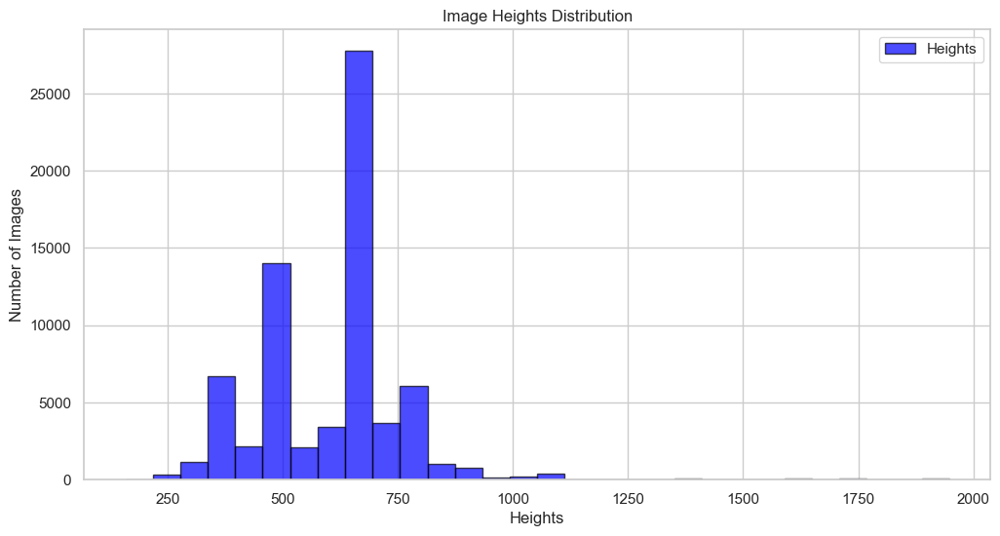

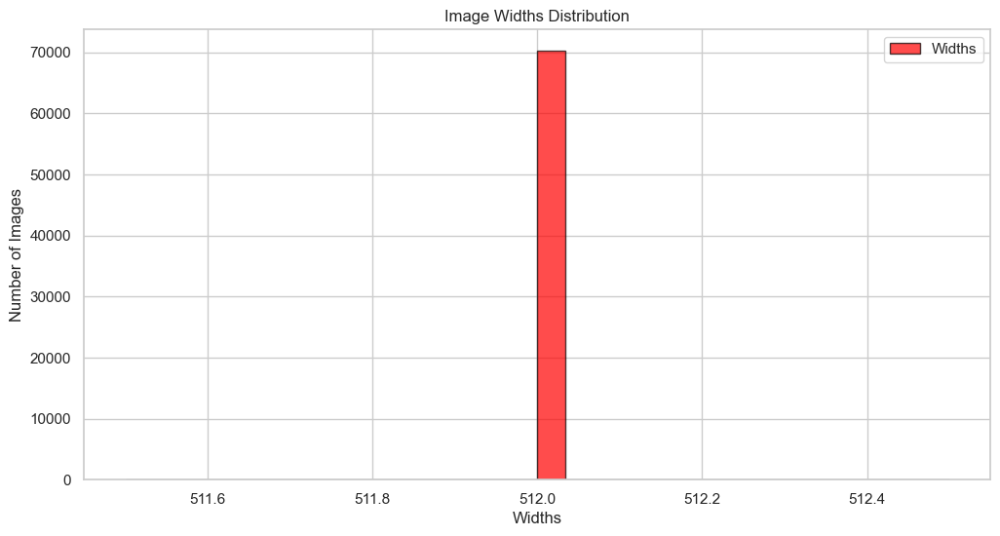

In [28]:
# plot the distribution of image heights and widths

plt.figure(figsize=(12, 6))
plt.hist(heights, bins=30, color='blue', alpha=0.7, label='Heights', edgecolor='black')
plt.title('Image Heights Distribution')
plt.xlabel('Heights')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

plt.figure(figsize=(12, 6))
plt.hist(widths, bins=30, color='red', alpha=0.7, label='Widths', edgecolor='black')
plt.title('Image Widths Distribution')
plt.xlabel('Widths')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

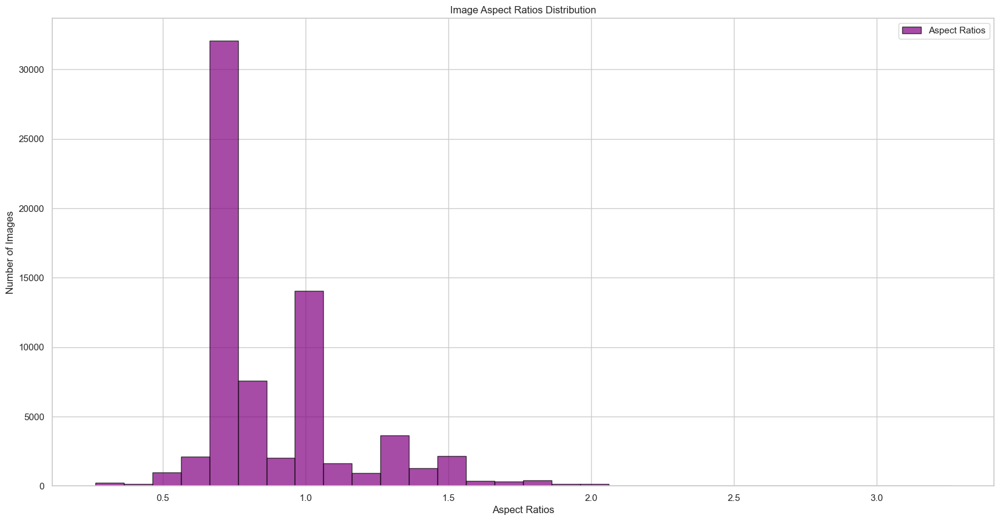

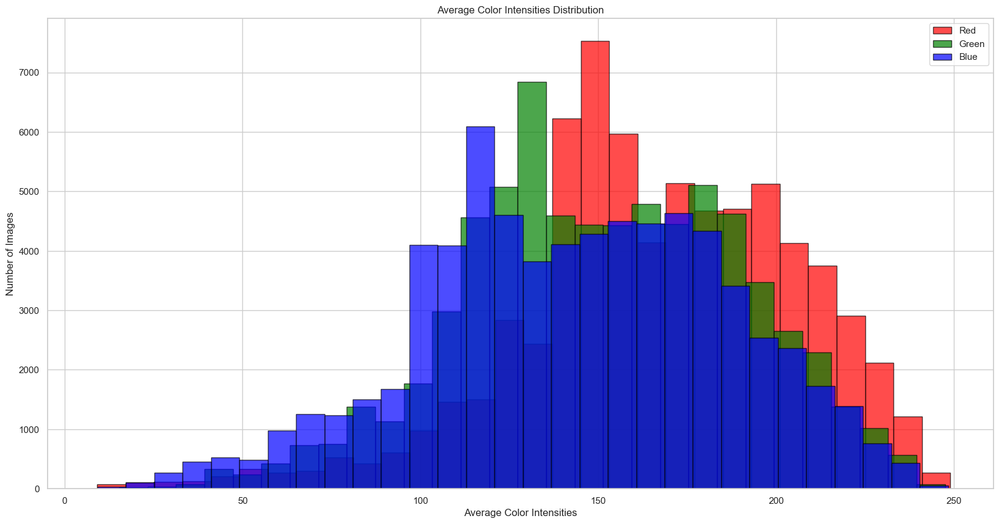

In [29]:
aspect_ratios = np.array(aspect_ratios)

plt.figure(figsize=(20, 10))
plt.hist(aspect_ratios, bins=30, color='purple', alpha=0.7, label='Aspect Ratios', edgecolor='black')
plt.title('Image Aspect Ratios Distribution')
plt.xlabel('Aspect Ratios')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

# plot the distribution of average color intensities

plt.figure(figsize=(20, 10))
plt.hist(avg_reds, bins=30, color='red', alpha=0.7, label='Red', edgecolor='black')
plt.hist(avg_greens, bins=30, color='green', alpha=0.7, label='Green', edgecolor='black')
plt.hist(avg_blues, bins=30, color='blue', alpha=0.7, label='Blue', edgecolor='black')
plt.title('Average Color Intensities Distribution')
plt.xlabel('Average Color Intensities')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

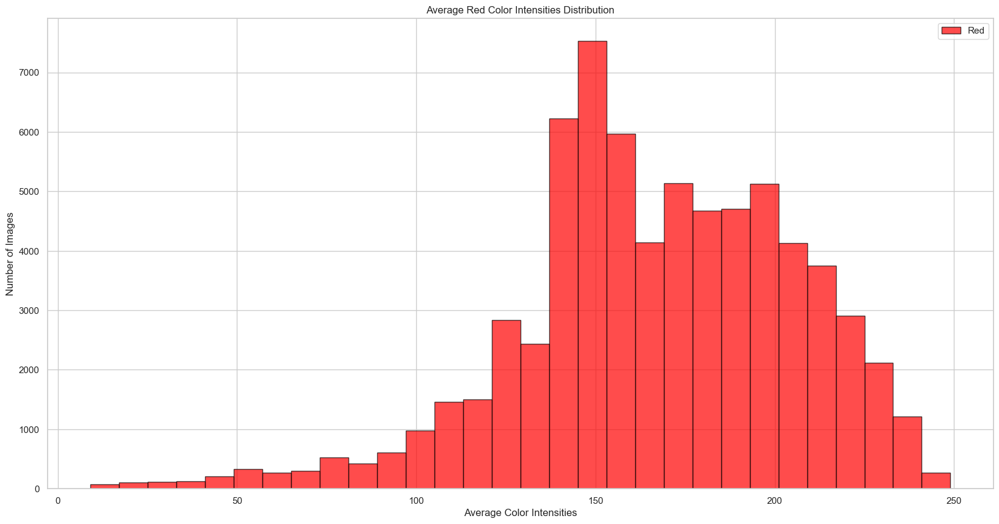

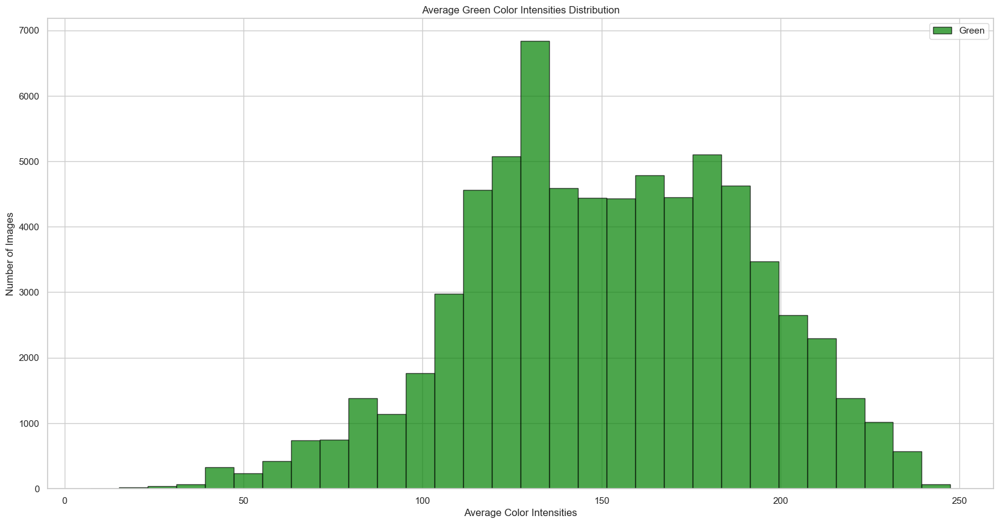

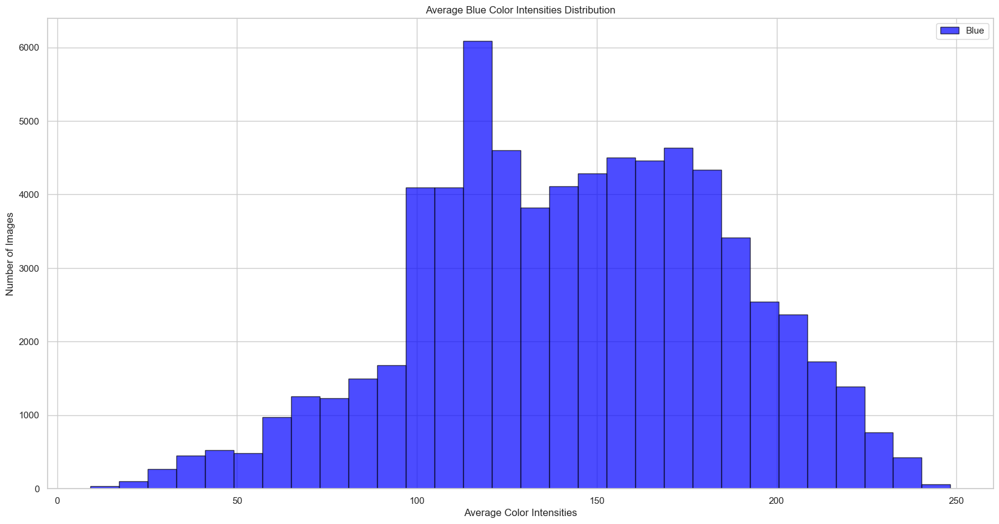

In [30]:
plt.figure(figsize=(20, 10))
plt.hist(avg_reds, bins=30, color='red', alpha=0.7, label='Red', edgecolor='black')
plt.title('Average Red Color Intensities Distribution')
plt.xlabel('Average Color Intensities')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

plt.figure(figsize=(20, 10))
plt.hist(avg_greens, bins=30, color='green', alpha=0.7, label='Green', edgecolor='black')
plt.title('Average Green Color Intensities Distribution')
plt.xlabel('Average Color Intensities')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

plt.figure(figsize=(20, 10))
plt.hist(avg_blues, bins=30, color='blue', alpha=0.7, label='Blue', edgecolor='black')
plt.title('Average Blue Color Intensities Distribution')
plt.xlabel('Average Color Intensities')
plt.ylabel('Number of Images')
plt.legend()
plt.show()

# Preprocessing

In [11]:
# Handling missingvalues
train_df1 = train_df.copy()
for col in train_df1.select_dtypes(include=['object']).columns:
    train_df1[col] = train_df1[col].fillna("Not Applicable")

In [17]:
train_df1.head()

,id,Category,len,attr_1,attr_2,attr_3,attr_4,attr_5,attr_6,attr_7,attr_8,attr_9,attr_10
0,0,Men Tshirts,5,default,round,printed,default,short sleeves,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable
1,1,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable
2,2,Men Tshirts,5,default,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable
3,3,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable
4,4,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable


In [13]:
train_df2 = train_df.copy()
for col in train_df2.columns:
    train_df2[f'{col}_missing'] = train_df2[col].isnull().astype(int)

In [14]:
train_df2.head()

,id,Category,len,attr_1,attr_2,attr_3,attr_4,attr_5,attr_6,attr_7,...,attr_1_missing,attr_2_missing,attr_3_missing,attr_4_missing,attr_5_missing,attr_6_missing,attr_7_missing,attr_8_missing,attr_9_missing,attr_10_missing
0,0,Men Tshirts,5,default,round,printed,default,short sleeves,NaN,NaN,...,0,0,0,0,0,1,1,1,1,1
1,1,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,NaN,NaN,...,0,0,0,0,0,1,1,1,1,1
2,2,Men Tshirts,5,default,polo,solid,solid,short sleeves,NaN,NaN,...,0,0,0,0,0,1,1,1,1,1
3,3,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,NaN,NaN,...,0,0,0,0,0,1,1,1,1,1
4,4,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,NaN,NaN,...,0,0,0,0,0,1,1,1,1,1


In [15]:
for col in train_df2.select_dtypes(include=['object']).columns:
    train_df2[col] = train_df2[col].fillna("Not Applicable")

In [16]:
train_df2.head()

,id,Category,len,attr_1,attr_2,attr_3,attr_4,attr_5,attr_6,attr_7,...,attr_1_missing,attr_2_missing,attr_3_missing,attr_4_missing,attr_5_missing,attr_6_missing,attr_7_missing,attr_8_missing,attr_9_missing,attr_10_missing
0,0,Men Tshirts,5,default,round,printed,default,short sleeves,Not Applicable,Not Applicable,...,0,0,0,0,0,1,1,1,1,1
1,1,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,...,0,0,0,0,0,1,1,1,1,1
2,2,Men Tshirts,5,default,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,...,0,0,0,0,0,1,1,1,1,1
3,3,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,...,0,0,0,0,0,1,1,1,1,1
4,4,Men Tshirts,5,multicolor,polo,solid,solid,short sleeves,Not Applicable,Not Applicable,...,0,0,0,0,0,1,1,1,1,1
